## Dataset download (coco)

In [3]:
import os
coco_dir = "/content/coco"
os.makedirs(coco_dir, exist_ok=True)

In [4]:
%%bash
cd /content/coco

echo "==Downloading coco images ==="
wget -nc http://images.cocodataset.org/zips/train2017.zip
wget -nc http://images.cocodataset.org/zips/val2017.zip

unzip -q train2017.zip
unzip -q val2017.zip

==Downloading coco images ===


--2025-11-30 11:51:45--  http://images.cocodataset.org/zips/train2017.zip
Resolving images.cocodataset.org (images.cocodataset.org)... 3.5.21.203, 16.15.196.197, 52.217.166.209, ...
Connecting to images.cocodataset.org (images.cocodataset.org)|3.5.21.203|:80... connected.
HTTP request sent, awaiting response... 200 OK
Length: 19336861798 (18G) [application/zip]
Saving to: ‘train2017.zip’

     0K .......... .......... .......... .......... ..........  0%  414K 12h40m
    50K .......... .......... .......... .......... ..........  0%  829K 9h30m
   100K .......... .......... .......... .......... ..........  0%  241M 6h20m
   150K .......... .......... .......... .......... ..........  0%  834K 6h19m
   200K .......... .......... .......... .......... ..........  0%  162M 5h4m
   250K .......... .......... .......... .......... ..........  0%  344M 4h13m
   300K .......... .......... .......... .......... ..........  0%  252M 3h37m
   350K .......... .......... .......... .......... ...

In [5]:
%%bash
cd /content/coco

echo "=== Downloading COCO Annotations ==="
wget -nc http://images.cocodataset.org/annotations/annotations_trainval2017.zip

unzip -q annotations_trainval2017.zip

=== Downloading COCO Annotations ===


--2025-11-30 12:04:53--  http://images.cocodataset.org/annotations/annotations_trainval2017.zip
Resolving images.cocodataset.org (images.cocodataset.org)... 52.217.99.236, 3.5.29.159, 16.15.195.147, ...
Connecting to images.cocodataset.org (images.cocodataset.org)|52.217.99.236|:80... connected.
HTTP request sent, awaiting response... 200 OK
Length: 252907541 (241M) [application/zip]
Saving to: ‘annotations_trainval2017.zip’

     0K .......... .......... .......... .......... ..........  0%  415K 9m55s
    50K .......... .......... .......... .......... ..........  0%  823K 7m27s
   100K .......... .......... .......... .......... ..........  0% 43.2M 5m0s
   150K .......... .......... .......... .......... ..........  0% 54.0M 3m46s
   200K .......... .......... .......... .......... ..........  0%  844K 3m59s
   250K .......... .......... .......... .......... ..........  0% 84.8M 3m20s
   300K .......... .......... .......... .......... ..........  0% 95.6M 2m52s
   350K ..........

## Sample dataset check (visualize)

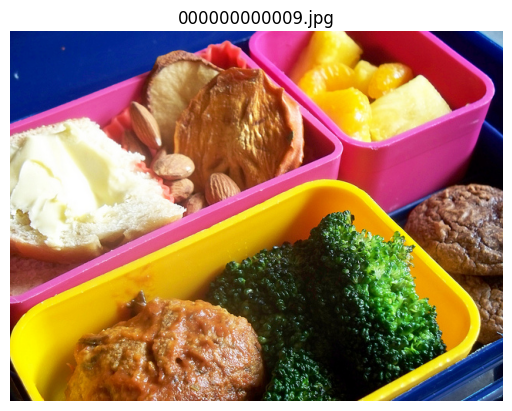

In [15]:
import cv2
import matplotlib.pyplot as plt

train_img_path = "/content/coco/train2017"
train_img_list = sorted(os.listdir(train_img_path))

sample = train_img_list[0]
path = train_img_path + '/' + sample
img = cv2.cvtColor(cv2.imread(path), cv2.COLOR_BGR2RGB)
plt.imshow(img)
plt.title(sample)
plt.axis('off')
plt.show()

## 1. Import library

In [20]:
import os
import cv2
import random
from PIL import Image
import json
import torch
from torch import nn
from torch.utils.data import Dataset, DataLoader
import torch.nn.functional as F
import torchvision.transforms.functional as TF
from torchvision.ops import box_iou
import torchvision
from typing import List, Dict, Tuple
from collections import defaultdict

## 2. Transforms (image, target)

In [25]:
class LetterboxResize:
    """
    YOLO 스타일의 aspect-ratio 유지 + padding 기반 resize.
    - image: PIL (W, H)
    - target['boxes']: [N, 4], xyxy (원본 좌표)
    - 출력: target_size x target_size 이미지 + 이에 맞게 변환된 boxes
    """
    def __init__(self, target_size: int):
        self.target_size = target_size

    def __call__(self, image, target):
        # 원본 크기
        orig_w, orig_h = image.size  # PIL: (W, H)

        # 1) scale factor 계산 (긴 변 기준으로 맞추지 않고, 짧은 변을 target_size에 맞춤)
        #    -> 원본 비율 유지하면서 target_size 안에 최대한 채우기
        scale = min(self.target_size / orig_w, self.target_size / orig_h)

        # 2) 리사이즈된 새 크기
        new_w = int(round(orig_w * scale))
        new_h = int(round(orig_h * scale))

        # 3) 이미지 resize
        resized = TF.resize(image, (new_h, new_w))  # (H, W)

        # 4) padding 크기 계산 (가운데 정렬)
        pad_w = self.target_size - new_w
        pad_h = self.target_size - new_h

        pad_left   = pad_w // 2
        pad_right  = pad_w - pad_left
        pad_top    = pad_h // 2
        pad_bottom = pad_h - pad_top

        # 5) pad 적용 (left, top, right, bottom)
        # PIL 이미지 기준
        padded = TF.pad(resized, (pad_left, pad_top, pad_right, pad_bottom), fill=0)

        # 6) bbox도 scale + pad 적용
        if "boxes" in target and target["boxes"].numel() > 0:
            boxes = target["boxes"].clone()  # [N,4] xyxy

            # scale
            boxes[:, [0, 2]] = boxes[:, [0, 2]] * scale  # x 좌표
            boxes[:, [1, 3]] = boxes[:, [1, 3]] * scale  # y 좌표

            # pad shift
            boxes[:, [0, 2]] = boxes[:, [0, 2]] + pad_left
            boxes[:, [1, 3]] = boxes[:, [1, 3]] + pad_top

            target["boxes"] = boxes

        # (선택) 나중에 inverse transform 등을 위해 scale / pad 저장하고 싶으면 여기 추가해도 됨
        # target["meta"] = {"scale": scale, "pad_left": pad_left, "pad_top": pad_top}

        return padded, target

class RandomHorizontalFlip:
  def __init__(self, p=0.5):
    self.p = p

  def __call__(self, img, target):
    if random.random() < self.p:
      w, h = img.size
      img = TF.hflip(img)

      # box 좌우 반전
      boxes = target['boxes'].clone()
      x_min = boxes[:, 0]
      x_max = boxes[:, 2]
      boxes[:, 0] = w - x_max
      boxes[:, 2] = w - x_min
      target['boxes'] = boxes

    return img, target


class RandomColorJitter:
  def __init__(self, brightness=0.2, contrast=0.2, p=0.8):
      self.brightness = brightness
      self.contrast = contrast
      self.p = p

  def __call__(self, image, target):
      if random.random() < self.p:
          # brightness
          b_factor = 1.0 + (random.random() * 2 - 1.0) * self.brightness  # 1±brightness
          image = TF.adjust_brightness(image, b_factor)
          # contrast
          c_factor = 1.0 + (random.random() * 2 - 1.0) * self.contrast
          image = TF.adjust_contrast(image, c_factor)
      return image, target

class ToTensorAndNormalize:
    def __init__(self):
        # ImageNet 통계 사용
        self.mean = torch.tensor([0.485, 0.456, 0.406]).view(3,1,1)
        self.std  = torch.tensor([0.229, 0.224, 0.225]).view(3,1,1)

    def __call__(self, image, target):
        # PIL -> Tensor [C,H,W], [0,1]
        image = TF.to_tensor(image)
        image = (image - self.mean) / self.std
        return image, target


In [18]:
class ComposeTransforms:
  def __init__(self, transforms):
    self.transforms = transforms

  def __call__(self, img, target):
    for t in self.transforms:
      img, target = t(img, target)

    return img, target

## 3. Custom Dataset

In [21]:
class COCODetectionDataset(Dataset):
  def __init__(self, img_dir, ann_file, transforms=None, filter_empty=True):
    self.img_dir = img_dir
    self.transforms = transforms

    # json load
    with open(ann_file, 'r') as f:
      coco = json.load(f)

    images = coco['images'] # 고유 id, file_name, width, height 정보
    annotations = coco['annotations'] #
    categories = coco['categories']

    # Image_id -> file_name 매핑
    self.img_id_to_info = {}
    for img in images:
      self.img_id_to_info[img["id"]] = {
          "file_name" : img['file_name'],
          "width" : img.get('width', None),
          "height" : img.get('height', None)
      }

    # category_id -> 연속 label (1, .. K) 매핑
    self.cat_id_to_contig = {}
    for i, cat in enumerate(categories):
      self.cat_id_to_contig[cat['id']] = i + 1
    self.num_classes = len(self.cat_id_to_contig) + 1

    # ---- image_id -> annotation 리스트 ----
    img_id_to_anns = defaultdict(list)
    for ann in annotations:
        if ann.get("iscrowd", 0) == 1:
            continue  # crowd는 여기선 스킵 (토이)
        img_id = ann["image_id"]
        img_id_to_anns[img_id].append(ann)

    # ---- 실제로 쓸 이미지 목록 구성 ----
    self.image_infos = []
    for img_id, info in self.img_id_to_info.items():
        anns_for_img = img_id_to_anns.get(img_id, [])
        if filter_empty and len(anns_for_img) == 0:
            # bbox 없는 이미지는 스킵
            continue
        self.image_infos.append({
            "id": img_id,
            "file_name": info["file_name"],
            "anns": anns_for_img,
        })

    print(f"[COCODetectionDataset] ann_file={os.path.basename(ann_file)}, "
          f"images with bbox={len(self.image_infos)}, "
          f"num_classes(incl. background=0)={self.num_classes}")

  def __len__(self):
    return len(self.image_infos)

  def __getitem__(self, idx):
    info = self.image_infos[idx]
    img_id = info['id']
    img_path = os.path.join(self.img_dir, info['file_name'])
    anns = info['anns']

    # 이미지 로드
    image = Image.open(img_path).convert('RGB')

    # annotations -> boxes, label
    boxes = []
    labels = []
    for ann in anns:
      if 'bbox' not in ann:
        continue

      x, y, w, h = ann['bbox']
      if w <= 0 or h <= 0:
        continue

      xmin = x
      ymin = y
      xmax = x+w
      ymax = y+h

      cat_id = ann['category_id']
      label = self.cat_id_to_contig[cat_id]

      boxes.append([xmin, ymin, xmax, ymax])
      labels.append(label)

    if len(boxes) == 0:
      # 혹시 filter_empty=False 인 경우 대비
      # 그냥 dummy 한개 추가하거나, 재샘플링 해도 됨
      # 여기선 간단하게 recursive 재호출
      return self.__getitem__((idx + 1) % len(self))

    boxes = torch.tensor(boxes, dtype=torch.float32)
    labels = torch.tensor(labels, dtype=torch.int64)

    target = {
        "boxes" : boxes,
        "labels" : labels,
        "image_id" : torch.tensor([img_id]),
    }

    if self.transforms is not None:
      image, target = self.transforms(image, target)

    return image, target


## 4. collate_fn

In [34]:
def detection_collate_fn(batch):
  images = [b[0] for b in batch]
  targets = [b[1] for b in batch]
  images = torch.stack(images, dim=0)

  return images, targets

## 5. Custom Model 구현

In [39]:
class SimpleDetector(nn.Module):
  """
  - backbone: 작은 CNN
  - head: feature map에서 각 위치마다 (box + class) 예측
  - output: pred_logits, pred_boxes
    pred_logits: [B, num_classes, H', W']
    pred_boxes:  [B, 4, H', W']  (x_c, y_c, w, h) in pixel coordinates
  """
  def __init__(self, num_classes, img_size, grid_size=20):
      super().__init__()
      self.num_classes = num_classes
      self.img_size = img_size
      self.grid_size = grid_size

      # 아주 간단한 CNN backbone
      self.backbone = nn.Sequential(
          nn.Conv2d(3, 32, 3, stride=2, padding=1),  # 160
          nn.BatchNorm2d(32),
          nn.ReLU(inplace=True),

          nn.Conv2d(32, 64, 3, stride=2, padding=1), # 80
          nn.BatchNorm2d(64),
          nn.ReLU(inplace=True),

          nn.Conv2d(64, 128, 3, stride=2, padding=1),# 40
          nn.BatchNorm2d(128),
          nn.ReLU(inplace=True),

          nn.Conv2d(128, 256, 3, stride=2, padding=1),# 20
          nn.BatchNorm2d(256),
          nn.ReLU(inplace=True),
      )

      # feature map 크기: [B,256, 20,20]
      # 각 grid 위치마다 num_classes + 4개 예측
      self.head_cls = nn.Conv2d(256, num_classes, 1)
      self.head_box = nn.Conv2d(256, 4, 1)

  def forward(self, x):
    feat = self.backbone(x)
    logits = self.head_cls(feat) #  (B, num_classes, h', w')
    box_reg = self.head_box(feat) # (B, 4, h', w')

    # box_reg는 직접 scale 조정 (예: x_c,y_c,w,h)
    # 여기서는 대충 (0~img_size) 범위로 맞추도록 sigmoid+scale
    B, _, Hf, Wf = box_reg.shape
    box_reg = torch.sigmoid(box_reg)
    # x_c, y_c: [0,1] 범위 -> image 좌표
    # w, h: [0,1] -> image width/height 비율
    x_c = box_reg[:, 0] * self.img_size
    y_c = box_reg[:, 1] * self.img_size
    w   = box_reg[:, 2] * self.img_size
    h   = box_reg[:, 3] * self.img_size

    # [B,4,H',W']로 다시 합치기
    box_reg = torch.stack([x_c, y_c, w, h], dim=1)

    return {
        "pred_logits": logits,
        "pred_boxes": box_reg,
    }



## 6. Custom loss functions

In [29]:
class SimpleDetectionLoss(nn.Module):
    """
    - 각 GT box를 feature map의 가장 가까운 grid 위치에 하나씩 할당
    - 그 위치에 대해:
        - class: cross entropy
        - box: smooth L1
    - 나머지 grid 위치: background (class 0)
    """
    def __init__(self, num_classes, img_size, grid_size=20,
                 lambda_box=1.0, lambda_cls=1.0):
        super().__init__()
        self.num_classes = num_classes
        self.img_size = img_size
        self.grid_size = grid_size
        self.lambda_box = lambda_box
        self.lambda_cls = lambda_cls

        # grid 좌표 미리 계산: feature map 상에서 (i,j) 위치의 중심이
        # image 상에서 대략 어느 좌표인지 (단순 비례)
        # 여기서는 그냥 box center를 img_size/grid_size 로 나눠서 index로 사용
        self.cell_size = img_size / grid_size

    def forward(self, outputs, targets):
        """
        outputs:
          pred_logits: [B, num_classes, Hf, Wf]
          pred_boxes:  [B, 4, Hf, Wf]  (x_c, y_c, w, h) in pixel
        targets: list of dict(len B)
          boxes: [N_i, 4] (xyxy)
          labels:[N_i]
        """
        pred_logits = outputs["pred_logits"]  # [B,C,Hf,Wf]
        pred_boxes = outputs["pred_boxes"]    # [B,4,Hf,Wf]
        B, C, Hf, Wf = pred_logits.shape

        # target tensor 초기화
        device = pred_logits.device
        tgt_classes = torch.zeros((B, Hf, Wf), dtype=torch.long, device=device)
        tgt_boxes = torch.zeros((B, 4, Hf, Wf), dtype=torch.float32, device=device)
        obj_mask = torch.zeros((B, Hf, Wf), dtype=torch.bool, device=device)

        for b in range(B):
            boxes = targets[b]["boxes"].to(device)  # [N,4]
            labels = targets[b]["labels"].to(device)  # [N]
            # xyxy -> x_center, y_center
            x_center = (boxes[:, 0] + boxes[:, 2]) / 2.0
            y_center = (boxes[:, 1] + boxes[:, 3]) / 2.0
            w = boxes[:, 2] - boxes[:, 0]
            h = boxes[:, 3] - boxes[:, 1]

            # feature map grid index
            gi = (x_center / self.cell_size).clamp(0, Wf-1).long()
            gj = (y_center / self.cell_size).clamp(0, Hf-1).long()

            for k in range(boxes.shape[0]):
                i = gi[k].item()
                j = gj[k].item()
                # 한 cell에 여러 box 들어오면 마지막만 남음 (토이니까 대충)
                tgt_classes[b, j, i] = labels[k]  # background=0, object=label
                tgt_boxes[b, 0, j, i] = x_center[k]
                tgt_boxes[b, 1, j, i] = y_center[k]
                tgt_boxes[b, 2, j, i] = w[k]
                tgt_boxes[b, 3, j, i] = h[k]
                obj_mask[b, j, i] = True

        # 1) classification loss
        # pred_logits: [B,C,H,W] -> [B,H,W,C] -> [B*H*W, C]
        cls_loss = F.cross_entropy(
            pred_logits.permute(0, 2, 3, 1).reshape(-1, C),
            tgt_classes.reshape(-1),
            reduction="mean"
        )

        # 2) box regression loss (positive cell만)
        if obj_mask.any():
            pred_boxes_pos = pred_boxes.permute(0, 2, 3, 1)[obj_mask]   # [Npos,4]
            tgt_boxes_pos = tgt_boxes.permute(0, 2, 3, 1)[obj_mask]     # [Npos,4]
            box_loss = F.smooth_l1_loss(pred_boxes_pos, tgt_boxes_pos, reduction="mean")
        else:
            box_loss = torch.tensor(0.0, device=device)

        loss = self.lambda_cls * cls_loss + self.lambda_box * box_loss

        return loss, {
            "loss": loss.item(),
            "cls_loss": cls_loss.item(),
            "box_loss": box_loss.item(),
        }

## 7. Main

In [40]:
device = "cuda" if torch.cuda.is_available() else "cpu"
image_size = 320
batch_size = 4
num_epochs = 5
num_workers = 2

root_dir = "/content/coco"
train_img_dir = os.path.join(root_dir, "train2017")
train_ann_dir = os.path.join(root_dir, "annotations", "instances_train2017.json")
val_img_dir = os.path.join(root_dir, "val2017")
val_ann_dir = os.path.join(root_dir, "annotations", "instances_val2017.json")

# =========================
# 2. Transforms (image, target) -> (image, target)
# =========================
train_transforms = ComposeTransforms([
    LetterboxResize(target_size=image_size),   # ✅ 새로 만든 transform
    RandomHorizontalFlip(p=0.5),
    RandomColorJitter(p=0.8),
    ToTensorAndNormalize(),
])

val_transforms = ComposeTransforms([
    LetterboxResize(target_size=image_size),   # val에도 같은 방식으로
    ToTensorAndNormalize(),
])

train_dataset_full = COCODetectionDataset(
    img_dir=train_img_dir,
    ann_file=train_ann_dir,
    transforms=train_transforms,
    filter_empty=True,
)

# 데모용으로 앞 2000장만
train_subset_indices = list(range(0, min(2000, len(train_dataset_full))))
train_dataset = torch.utils.data.Subset(train_dataset_full, train_subset_indices)

train_loader = DataLoader(
    train_dataset,
    batch_size=batch_size,
    shuffle=True,
    num_workers=num_workers,
    collate_fn=detection_collate_fn,
)

val_dataset_full = COCODetectionDataset(
    img_dir=val_img_dir,
    ann_file=val_ann_dir,
    transforms=val_transforms,
    filter_empty=True,
)
val_subset_indices = list(range(0, min(256, len(val_dataset_full))))
val_dataset = torch.utils.data.Subset(val_dataset_full, val_subset_indices)

val_loader = DataLoader(
    val_dataset,
    batch_size=batch_size,
    shuffle=False,
    num_workers=num_workers,
    collate_fn=detection_collate_fn,
)

num_classes = train_dataset_full.num_classes
print("num_classes (including background=0):", num_classes)

model = SimpleDetector(num_classes=num_classes, img_size=image_size, grid_size=20).to(device)
criterion = SimpleDetectionLoss(num_classes=num_classes, img_size=image_size, grid_size=20)
optimizer = torch.optim.Adam(model.parameters(), lr=1e-3)


# =========================
# 8. Train loop
# =========================
for epoch in range(num_epochs):
    model.train()
    running_loss = 0.0
    for step, (images, targets) in enumerate(train_loader):
        images = images.to(device)

        outputs = model(images)
        loss, loss_dict = criterion(outputs, targets)

        optimizer.zero_grad()
        loss.backward()
        optimizer.step()

        running_loss += loss.item()
        if (step + 1) % 20 == 0:
            print(f"[Epoch {epoch+1}/{num_epochs}] Step {step+1}/{len(train_loader)} "
                  f"Loss: {running_loss / (step+1):.4f} "
                  f"(cls={loss_dict['cls_loss']:.4f}, box={loss_dict['box_loss']:.4f})")

    model.eval()
    val_loss = 0.0
    with torch.no_grad():
        for images, targets in val_loader:
            images = images.to(device)
            outputs = model(images)
            loss, _ = criterion(outputs, targets)
            val_loss += loss.item()
    val_loss /= len(val_loader)
    print(f"Epoch {epoch+1} done. Train loss={running_loss/len(train_loader):.4f}, "
          f"Val loss={val_loss:.4f}")

Streaming output truncated to the last 5000 lines.
          ...,
          [-1.6643, -1.7993, -1.5887,  ..., -1.5941, -1.5890, -1.4975],
          [-2.3282, -5.1569, -4.9144,  ..., -4.6852, -4.6490, -4.6041],
          [-2.5304, -5.9787, -5.9787,  ..., -5.9787, -5.9787, -5.9787]],

         [[-2.0070, -2.8858, -2.8858,  ..., -2.8858, -2.8858, -2.8858],
          [-2.4639, -5.2152, -5.2152,  ..., -5.2152, -5.2152, -5.2152],
          [-2.0031, -3.5244, -3.5394,  ..., -3.3663, -3.4204, -3.3853],
          ...,
          [-1.9178, -2.1497, -1.9431,  ..., -2.0107, -1.9591, -1.8215],
          [-2.3451, -4.5697, -4.4012,  ..., -4.2139, -4.1238, -3.9521],
          [-2.4639, -5.2152, -5.2152,  ..., -5.2152, -5.2152, -5.2152]],

         ...,

         [[-1.7117, -2.8509, -2.8509,  ..., -2.8509, -2.8509, -2.8509],
          [-2.6563, -6.1291, -6.1291,  ..., -6.1291, -6.1291, -6.1291],
          [-2.1294, -4.3440, -4.3502,  ..., -4.1311, -4.1944, -4.1925],
          ...,
          [-1.8147, -

KeyboardInterrupt: 